<a href="https://colab.research.google.com/github/SynBioExplorer/Navigating-the-frontier-of-Synthetic-Biology-An-AI-driven-platform-for-exploring-research-trends-an/blob/main/NLP_analysis_of_Synthetic_Biology.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>



# **Library import**

In [ ]:
!pip install pandas-profiling
!pip install torch
!pip install geopy
!pip install chart_studio

In [ ]:
import pandas as pd
import numpy as np
import plotly.express as px
from plotly.subplots import make_subplots
import plotly.graph_objects as go
from matplotlib import pyplot as plt
from matplotlib import cm
import re


In [ ]:
from pandas_profiling import ProfileReport
from datetime import datetime
#from umap import UMAP


In [ ]:
import chart_studio
chart_studio.tools.set_credentials_file(username='xxx', api_key='xxxx')
import chart_studio.plotly as py


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

# **Data preprocessing**

In [ ]:
#import data
file1=pd.read_excel('/content/drive/MyDrive/Coding data/18k_articles.xlsx')

In [ ]:
file1

,Unnamed: 0,Publication Type,Authors,Book Authors,Book Editors,Book Group Authors,Author Full Names,Book Author Full Names,Group Authors,Article Title,...,Web of Science Index,Research Areas,IDS Number,Pubmed Id,Open Access Designations,Highly Cited Status,Hot Paper Status,Date of Export,UT (Unique WOS ID),Web of Science Record
0,0,J,"Nguyen, A",NaN,NaN,NaN,"Nguyen, Anthony",NaN,NaN,A functional naturalism,...,Science Citation Index Expanded (SCI-EXPANDED)...,History & Philosophy of Science; Philosophy,PV6LP,NaN,NaN,NaN,NaN,2022-09-26,WOS:000610097900012,0
1,1,J,"Glock, P; Broichhagen, J; Kretschmer, S; Blumh...",NaN,NaN,NaN,"Glock, Philipp; Broichhagen, Johannes; Kretsch...",NaN,NaN,Optical Control of a Biological Reaction-Diffu...,...,Science Citation Index Expanded (SCI-EXPANDED),Chemistry,FW6UE,29266672.0,NaN,NaN,NaN,2022-09-26,WOS:000425453300013,0
2,2,J,"Hirokawa, Y; Kawano, H; Tanaka-Masuda, K; Naka...",NaN,NaN,NaN,"Hirokawa, Yasutaka; Kawano, Hiroaki; Tanaka-Ma...",NaN,NaN,Genetic manipulations restored the growth fitn...,...,Science Citation Index Expanded (SCI-EXPANDED),Biotechnology & Applied Microbiology; Food Sci...,174QX,23477741.0,NaN,NaN,NaN,2022-09-26,WOS:000321171600009,0
3,3,J,"VanDyke, D; Wang, WT; Spangler, JB",NaN,NaN,NaN,"VanDyke, Derek; Wang, Wentao; Spangler, Jamie B.",NaN,NaN,Innovative synthetic signaling technologies fo...,...,Science Citation Index Expanded (SCI-EXPANDED),Engineering,SJ2AS,NaN,Bronze,NaN,NaN,2022-09-26,WOS:000655330100002,0
4,4,J,"Racle, J; Overney, J; Hatzimanikatis, V",NaN,NaN,NaN,"Racle, Julien; Overney, Jan; Hatzimanikatis, V...",NaN,NaN,A computational framework for the design of op...,...,Science Citation Index Expanded (SCI-EXPANDED),Biotechnology & Applied Microbiology,961GE,22334333.0,NaN,NaN,NaN,2022-09-26,WOS:000305451400025,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
17745,995,J,"Palluk, S; Arlow, DH; de Rond, T; Barthel, S; ...",NaN,NaN,NaN,"Palluk, Sebastian; Arlow, Daniel H.; de Rond, ...",NaN,NaN,De novo DNA synthesis using polymerase-nucleot...,...,Science Citation Index Expanded (SCI-EXPANDED),Biotechnology & Applied Microbiology,GM4IN,29912208.0,"Green Published, Green Submitted",NaN,NaN,2022-09-26,WOS:000438082000024,0
17746,996,J,"Karagyaur, M; Dzhauari, S; Basalova, N; Aleksa...",NaN,NaN,NaN,"Karagyaur, Maxim; Dzhauari, Stalik; Basalova, ...",NaN,NaN,MSC Secretome as a Promising Tool for Neuropro...,...,Science Citation Index Expanded (SCI-EXPANDED),Pharmacology & Pharmacy,XX5FN,34959314.0,"Green Published, gold",NaN,NaN,2022-09-26,WOS:000736321400001,0
17747,997,J,"Chicherin, IV; Dukhalin, SV; Khannanov, RA; Ba...",NaN,NaN,NaN,"Chicherin, I., V; Dukhalin, S., V; Khannanov, ...",NaN,NaN,Functional Diversity of Mitochondrial Peptidyl...,...,Science Citation Index Expanded (SCI-EXPANDED),Biochemistry & Molecular Biology,TS7FK,34336930.0,"Green Published, gold",NaN,NaN,2022-09-26,WOS:000679812000001,0
17748,998,J,"Tucker, IM; Burley, A; Petkova, RE; Hosking, S...",NaN,NaN,NaN,"Tucker, I. M.; Burley, A.; Petkova, R. E.; Hos...",NaN,NaN,"Self-assembly in saponin mixtures: Escin/tea, ...",...,Science Citation Index Expanded (SCI-EXPANDED),Chemistry,WB4TW,NaN,Green Accepted,NaN,NaN,2022-09-26,WOS:000703567000006,0


In [ ]:
file1['Publication Type'].value_counts()

J    16133
S      760
C      498
B      359
Name: Publication Type, dtype: int64

In [ ]:
file1.columns

Index(['Unnamed: 0', 'Publication Type', 'Authors', 'Book Authors',
       'Book Editors', 'Book Group Authors', 'Author Full Names',
       'Book Author Full Names', 'Group Authors', 'Article Title',
       'Source Title', 'Book Series Title', 'Book Series Subtitle', 'Language',
       'Document Type', 'Conference Title', 'Conference Date',
       'Conference Location', 'Conference Sponsor', 'Conference Host',
       'Author Keywords', 'Keywords Plus', 'Abstract', 'Addresses',
       'Affiliations', 'Reprint Addresses', 'Email Addresses',
       'Researcher Ids', 'ORCIDs', 'Funding Orgs', 'Funding Name Preferred',
       'Funding Text', 'Cited References', 'Cited Reference Count',
       'Times Cited, WoS Core', 'Times Cited, All Databases',
       '180 Day Usage Count', 'Since 2013 Usage Count', 'Publisher',
       'Publisher City', 'Publisher Address', 'ISSN', 'eISSN', 'ISBN',
       'Journal Abbreviation', 'Journal ISO Abbreviation', 'Publication Date',
       'Publication Year', '

In [ ]:
#how many nans per column?
file1['Publication Type'].value_counts()

J    16133
S      760
C      498
B      359
Name: Publication Type, dtype: int64

In [ ]:
#drop all empty columns
file1=file1.drop(labels=['Unnamed: 0','Book Authors','Book Editors','Book Group Authors','Book Author Full Names','Group Authors','Book Series Title','Book Series Subtitle','Language','Conference Sponsor','Affiliations','Researcher Ids','ORCIDs','Funding Name Preferred','Cited References','Publisher','Publisher City','Publisher Address','ISSN','eISSN','Journal Abbreviation','ISBN','Volume','Issue','Part Number', 'Supplement','Special Issue', 'Meeting Abstract', 'Start Page', 'End Page','Article Number','Reprint Addresses','Funding Text','DOI Link','Early Access Date','Number of Pages','WoS Categories', 'Web of Science Index','IDS Number','Open Access Designations','Highly Cited Status', 'Hot Paper Status', 'Date of Export','Web of Science Record'],axis=1)
#only columns where abstract and publication year is not 0 (=drop 100 rows)
file1 = file1[file1['Abstract'].notna()]
file1 = file1[file1['Publication Year'].notna()]
file1 = file1[file1['Authors'].notna()]
file1 = file1[file1['Addresses'].notna()]
file1.reset_index(drop=True)

#I am mostly interested in Journal articles, not book chapters, proceeding papers(not peer reviewed) etc
J=['J']
file1=file1[file1['Publication Type'].isin(J)]

#for topic model, just look at abstract and publication year
file1['Abstract']=file1['Abstract'].astype(str)
abstracts_df=file1[['Abstract','Publication Year']]
abstracts_df=abstracts_df.rename(columns={'Publication Year':'Publication_Year'})

#format and remove special characters from text
abstracts_df.Abstract = abstracts_df.apply(lambda row: re.sub(r"http\S+", "", row.Abstract).lower(), 1)
abstracts_df.Abstract = abstracts_df.apply(lambda row: " ".join(filter(lambda x:x[0]!="@", row.Abstract.split())), 1)
abstracts_df.Abstract = abstracts_df.apply(lambda row: " ".join(re.sub("[^a-zA-Z]+", " ", row.Abstract).split()), 1)
timestamps = abstracts_df.Publication_Year.to_list()
docs = abstracts_df.Abstract.to_list()

In [ ]:
#ProfileReport(file1) #EDA, good for exploratory data anlayis

# **Comparison to Scopus query**

In [ ]:
scopus=pd.read_csv('/content/drive/MyDrive/Coding data/scopus.csv')
file1=pd.read_excel('/content/drive/MyDrive/Coding data/18k_articles.xlsx')

In [ ]:
J=['J']
file1=file1[file1['Publication Type'].isin(J)]
sco=['Article','Review']
scopus=scopus[scopus['Document Type'].isin(sco)]
scopus=scopus.dropna(subset=['PubMed ID'])
scopus['PubMed ID']=scopus['PubMed ID'].astype('int64')
file1=file1.dropna(subset=['DOI'])
scopus=scopus.dropna(subset=['DOI'])

In [ ]:
import pandas as pd
from matplotlib import pyplot as plt
from matplotlib_venn import venn2
from matplotlib_venn import venn3

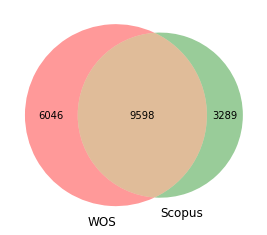

In [ ]:
#overlap between journal articles of Scopus and Web of Science dataset
venn2([set(file1['DOI'].to_list()), 
       set(scopus['DOI'].to_list())],
       set_labels=('WOS', 'Scopus')
     )

# **World Cloud**

In [ ]:
!pip install wordcloud
from wordcloud import WordCloud

In [ ]:
txt=file1['Keywords Plus'].str.cat(sep=', ')

news_wordcloud = WordCloud( width = 800, height = 800, 
                background_color ='white',  
                collocations=False,
                min_font_size = 10).generate(txt)

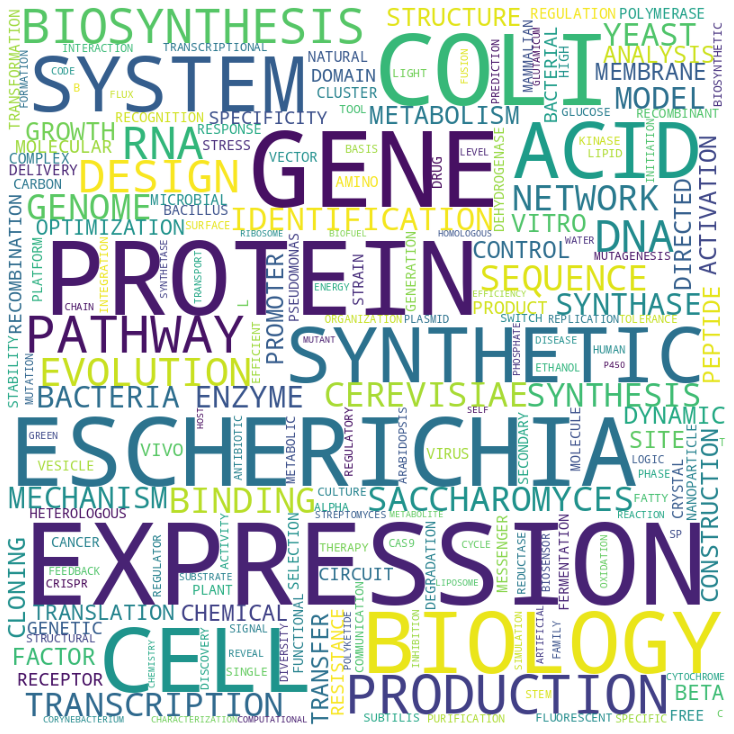

In [ ]:
#wordcloud of most frequent topics in abstracts of Web of Science Dataset
import matplotlib.pyplot as plt
%matplotlib inline
plt.figure(figsize = (10, 10), facecolor = 'None') 
plt.imshow(news_wordcloud) 
plt.axis("off") 
plt.tight_layout(pad = 0) 
plt.savefig('wordcloud.png')
plt.show()

# **Histogram of publication counts**

In [ ]:
file2=file1[['Publication Year','Article Title']]
file2=file2.rename(columns={'Publication Year':'Year','Article Title':'Count'})
file2=file2.groupby(['Year']).count().reset_index()
file2=file2.loc[3:19]
file2


,Year,Count
3,2005.0,24
4,2006.0,35
5,2007.0,73
6,2008.0,92
7,2009.0,174
8,2010.0,239
9,2011.0,323
10,2012.0,605
11,2013.0,731
12,2014.0,900


In [ ]:
fig = px.bar(file2, x='Year',y='Count', template= 'xgridoff',labels={'Year':'Publication year','Count':'Publication count'}, width=500, height=500 )
fig.update_layout(xaxis_range=[2004,2023], plot_bgcolor='white', xaxis_color='black', yaxis_color='black')
fig.update_xaxes(tickcolor='black', showgrid=False, gridcolor='lightgray', showline=True, linewidth=2, linecolor='black')
fig.update_yaxes(tickcolor='black', showgrid=False, gridcolor='lightgray', showline=True, linewidth=2, linecolor='black')
fig.show()
fig.write_html('pubmed_hist.html')

# **Topic Modelling**

In [ ]:
#!pip install --upgrade joblib==1.1.0
!pip install umap-learn
!pip install sentence-transformers
!pip install pytorch
!pip install bertopic
#!pip install https://github.com/pandas-profiling/pandas-profiling/archive/master.zip 
!pip install bertopic[visualization]
!pip install hdbscan
!pip install https:://github.com/huggingface/transformers/
!pip install openai

In [ ]:
from hdbscan import HDBSCAN
from sklearn.cluster import KMeans
from sentence_transformers import SentenceTransformer
from sklearn.feature_extraction.text import CountVectorizer
from bertopic import BERTopic
from bertopic.representation import MaximalMarginalRelevance
from umap import UMAP
from bertopic.vectorizers import ClassTfidfTransformer
import openai
from bertopic.representation import OpenAI

In [ ]:
#train the model on the web of science dataset


# Step 1 - Extract embeddings
sentence_model = SentenceTransformer("all-mpnet-base-v2")
#embeddings = sentence_model.encode(docs, show_progress_bar=True)
# Step 2 - Reduce dimensionality
umap_model = UMAP(n_neighbors=15, n_components=5, min_dist=0.0, metric='cosine')
# Step 3 - Cluster reduced embeddings
hdbscan_model = HDBSCAN(min_cluster_size=15, metric='euclidean', cluster_selection_method='eom', prediction_data=True)
# Step 4 - Tokenize topics
vectorizer_model = CountVectorizer(ngram_range=(1, 3), stop_words="english")
# Step 5 - Create topic representation
ctfidf_model = ClassTfidfTransformer()
# Step 6 - Fine-tune topic representations 
#representation_model = MaximalMarginalRelevance(diversity=0.3)
# Create your representation model
openai.api_key = 'xxx'
representation_model = OpenAI(model="gpt-3.5-turbo", chat=True)

In [ ]:
# specify parameters for BERTopic model
topic_model = BERTopic(
  calculate_probabilities=True,
  nr_topics=100,                            # limit to 100 topics
  embedding_model=sentence_model,           # Step 1 - embedd sentences into vector space
  umap_model=umap_model,                    # Step 2 - Reduce dimensionality
  hdbscan_model=hdbscan_model,              # Step 3 - Cluster reduced embeddings
  vectorizer_model=vectorizer_model,        # Step 4 - Tokenize topics
  ctfidf_model=ctfidf_model,                # Step 5 - Extract topic words
  representation_model=representation_model # Step 6 - (Optional) Fine-tune topic represenations
)


In [ ]:
# train and fit the model to the WOS dataser
topics, probs = topic_model.fit_transform(docs)

In [ ]:
#save model 
topic_model.save('/content/drive/MyDrive/Coding data/final_gpt_model_24_03')


In [ ]:
#load model
topic_model=BERTopic.load('/content/drive/MyDrive/Coding data/final_gpt_model_24_03')

In [ ]:
#reduce outliers of model based on c-TF-IDF scores
new_topics=topic_model.reduce_outliers(docs, topics)
topic_model.update_topics(docs, topics=new_topics,representation_model=representation_model, n_gram_range=(1, 4))

In [ ]:
#topic modelling results with respective frequency
topic_model.get_topic_info()

,Topic,Count,Name
0,0,2371,0_Importance of Synthetic Biology for Research...
1,1,766,1_Genome Editing with CRISPR-Cas System in Yea...
2,2,1238,2_Gene expression control using synthetic prom...
3,3,1162,3_Microbial Metabolic Engineering for Sustaina...
4,4,474,4_Sustainable production of important chemical...
...,...,...,...
94,94,25,94_Microbial Acid Stress Tolerance in Industri...
95,95,32,95_Biosynthesis and role of cyanogenic glucosi...
96,96,20,96_Postharvest treatments to enhance phenolic ...
97,97,17,97_Glycosylation and Biosynthesis of Polysacch...


In [ ]:
#download the topics to a csv file
df=topic_model.get_topic_info()
df.to_csv('gpt_topics.csv')
from google.colab import files
files.download("gpt_topics.csv")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
#document level visualisation of topic clusters (useful for verification)
fig=topic_model.visualize_documents(docs,hide_annotations=True)
fig.update_layout(plot_bgcolor='white', xaxis_color='black', yaxis_color='black',width=2000,height=2000)
fig.show()
fig.write_html('doc_vis3.html')

In [ ]:
hierarchical_topics = topic_model.hierarchical_topics(docs)


100%|██████████| 98/98 [02:50<00:00,  1.74s/it]


In [ ]:
fig=topic_model.visualize_hierarchy(color_threshold=1.3)
fig.show()
fig.write_html('hiearchy_color_threshold2.html')

In [ ]:
#visualise hierarchy on document level with addional topics
fig = topic_model.visualize_hierarchical_documents(docs, hierarchical_topics)
fig.show()

In [ ]:
 #top 100 (all) topics
top100=topic_model.get_topic_info()
top100=top100.sort_values(by='Count', ascending=False)
top100lst=top100.Topic.tolist()
 topic_model._outliers = 0
 fig=topic_model.visualize_heatmap(width=1250, height=1250)
 fig.update_layout(font=dict(family="Verdana",size=6))
 fig.show()

 fig.write_html('heatmap.html')
 py.plot(fig, filename = 'heatmap', auto_open=True)

'https://plotly.com/~SynBio/95/'

In [ ]:
#only top 50 most frequent topics
top50=topic_model.get_topic_info()
top50=top50.sort_values(by='Count', ascending=False)
top50=top50.iloc[0:50]
top50lst=top50.Topic.tolist()
fig=topic_model.visualize_heatmap(topics=top50lst,width=1250,height=1250)
fig.write_html('heatmap_top50_.html')
fig.show()
py.plot(fig, filename = 'heatmap_top50', auto_open=True)

'https://plotly.com/~SynBio/99/'

# **Dynamic Topic Modelling**

In [ ]:
#calculate topic over time (re-calculates topic label for each year but displays overall label)
dynamic_topics = topic_model.topics_over_time(docs, timestamps)

In [ ]:
#import data
dynamic_topics=pd.read_csv('/content/dynamic_topics.csv')
gpt_topics=pd.read_csv('/content/GPT_onetable.csv')

In [ ]:
#data preprocessing:
gpt_topics=gpt_topics.reset_index()
gpt_topics=gpt_topics.rename(columns={'index':'index_by_total_occurance'})
dynamic_topics['Timestamp']=dynamic_topics.Timestamp.astype(int)
sums=dynamic_topics.groupby('Timestamp').agg({'Frequency':'sum'})
sums=sums.reset_index()
sums=sums.rename(columns={'Frequency':'Total_count'})
dynamic_topics=dynamic_topics.merge(sums, how='left',on='Timestamp')
dynamic_topics=dynamic_topics.drop(['Unnamed: 0'],axis=1)
dynamic_topics['Topic_percentage']=dynamic_topics['Frequency']/dynamic_topics['Total_count']*100
dynamic_topics['Topic_percentage']=dynamic_topics['Topic_percentage'].round(decimals=2)
dynamic_topics=dynamic_topics.loc[(dynamic_topics['Timestamp']>2004)& (dynamic_topics['Timestamp']<2022)]
dynamic_topics=dynamic_topics.merge(gpt_topics,how='left', on='Topic')
dynamic_topics['Original_Definition']=dynamic_topics['Topic'].astype(str)+'_'+dynamic_topics['Original_Definition']

In [ ]:
import re
import plotly.express as px
#Graph displaying occurance of topics over time as absolute occurance (e.g. 55 articles with topic 'CRISPR Cas' in 2018)

# extract first 3 words from 'Original_Definition'
dynamic_topics['Topic Description'] = dynamic_topics['Original_Definition'].apply(lambda x: re.match(r'^[^\s]+(\s+[^\s]+){0,2}', x).group() if re.match(r'^[^\s]+(\s+[^\s]+){0,2}', x) else '')

# get the unique values in 'Topic Description' column
unique_topics = dynamic_topics['Topic Description'].unique()

# create a dictionary with the count of occurrences of each unique topic in 'Topic Description' column
count_dict = {}
for topic in unique_topics:
    count_dict[topic] = dynamic_topics[dynamic_topics['Topic Description'] == topic]['index_by_total_occurance'].iloc[0]

# sort the dictionary by values (count of occurrences)
sorted_dict = dict(sorted(count_dict.items(), key=lambda item: item[1]))

# get the keys of the sorted dictionary in a list
sorted_topics = list(sorted_dict.keys())

# plot the line chart with modified legend
fig = px.line(dynamic_topics, x='Timestamp', y='Frequency', color='Topic Description', 
              hover_data=['Words'],
              labels={'Timestamp':'Publication Year'},
              category_orders={'Topic Description': sorted_topics}) # add the 'category_orders' parameter to the function call
fig.update_layout(xaxis_range=[2005, 2021], plot_bgcolor='white', 
                  xaxis_color='black', yaxis_color='black', width=1000, height=750)
fig.update_xaxes(tickcolor='black', showgrid=False, gridcolor='lightgray', showline=True, linewidth=2, linecolor='black')
fig.update_yaxes(tickcolor='black', showgrid=True, gridcolor='lightgray', showline=True, linewidth=2, linecolor='black')
fig.show()
fig.write_html('/content/dynamic_topic_modelling_absolute.html')
py.plot(fig, filename = 'dynamic_topic_modelling_absolute', auto_open=True)

'https://plotly.com/~SynBio/93/'

In [ ]:
import re
import plotly.express as px
#Graph highlighting the percentage distribution per year of the total corpus of each topic per year
# e.g. What percentage of papers published in 2019 deal with 'CRISPR-Cas'


# extract first 3 words from 'Original_Definition'
dynamic_topics['Topic Description'] = dynamic_topics['Original_Definition'].apply(lambda x: re.match(r'^[^\s]+(\s+[^\s]+){0,2}', x).group() if re.match(r'^[^\s]+(\s+[^\s]+){0,2}', x) else '')

# get the unique values in 'Topic Description' column
unique_topics = dynamic_topics['Topic Description'].unique()

# create a dictionary with the count of occurrences of each unique topic in 'Topic Description' column
count_dict = {}
for topic in unique_topics:
    count_dict[topic] = dynamic_topics[dynamic_topics['Topic Description'] == topic]['index_by_total_occurance'].iloc[0]

# sort the dictionary by values (count of occurrences)
sorted_dict = dict(sorted(count_dict.items(), key=lambda item: item[1]))

# get the keys of the sorted dictionary in a list
sorted_topics = list(sorted_dict.keys())

# plot the line chart with modified legend
fig = px.line(dynamic_topics, x='Timestamp', y='Topic_percentage', color='Topic Description', 
              hover_data=['Topic Description'],
              labels={'Topic_percentage': 'Percentage per year','Timestamp':'Publication Year'},
              category_orders={'Topic Description': sorted_topics}) # add the 'category_orders' parameter to the function call
fig.update_layout(xaxis_range=[2005, 2022], yaxis_range=[0, 50], plot_bgcolor='white', 
                  xaxis_color='black', yaxis_color='black', width=1000, height=750)
fig.update_xaxes(tickcolor='black', showgrid=False, gridcolor='lightgray', showline=True, linewidth=2, linecolor='black')
fig.update_yaxes(tickcolor='black', showgrid=True, gridcolor='lightgray', showline=True, linewidth=2, linecolor='black')
fig.show()
fig.write_html('/content/dynamic_topic_modelling_linegraph.html')
py.plot(fig, filename = 'dynamic_topic_modelling_linegraph', auto_open=True)

'https://plotly.com/~SynBio/91/'

In [ ]:
#Graph depicting the share of topics over time as part of the whole corpus per year with the defintions from the static model
import plotly.graph_objs as go

fig = go.Figure(
    go.Bar(
        x=dynamic_topics['Timestamp'],
        y=dynamic_topics['Topic_percentage'],
        marker_color=dynamic_topics['Topic'],
        text=dynamic_topics['Topic'],
        hovertemplate='%{text}: %{y:.2f}%<br>Original Definition: %{customdata}',
        textangle=90,
        textposition='inside',
        customdata=dynamic_topics['Original_Definition'],
        name='Topics'
    )
)
fig.update_layout(
    xaxis_title='Publication Year',
    yaxis_title='Percentage',
    xaxis_range=[2004, 2022],
    yaxis_range=[0, 100],
    plot_bgcolor='white',
    xaxis_color='black',
    yaxis_color='black',
    width=1000,
    height=750,
    legend=dict(
        yanchor="top",
        y=0.99,
        xanchor="left",
        x=0.01
    )
)
fig.update_xaxes(
    tickcolor='black',
    showgrid=False,
    gridcolor='lightgray',
    showline=True,
    linewidth=2,
    linecolor='black'
)
fig.update_yaxes(
    tickcolor='black',
    showgrid=True,
    gridcolor='lightgray',
    showline=True,
    linewidth=2,
    linecolor='black'
)
fig.show()
fig.write_html('/content/dynamic_topic_modelling_barchart.html')
py.plot(fig, filename = 'dynamic_topic_modelling_barchart', auto_open=True)

'https://plotly.com/~SynBio/89/'

# **Visualise journals (Which Journals are most popular in the dataset?)**

In [ ]:
#data preparation
subset = file1[['Publication Type','Source Title','Times Cited, All Databases']]
#filter out non journal articles
J=['J']
subset=subset[subset['Publication Type'].isin(J)]
#generate a df that describes mean citiation count
cited_mean=subset.groupby(['Source Title']).mean().reset_index()
cited_mean=cited_mean.rename(columns={'Times Cited, All Databases':'mean_citations','Source Title':'Journal'})
cited_mean.mean_citations=cited_mean.mean_citations.round(decimals=2)
#generate a df that describes total citations per journal
paper_count=subset.groupby(['Source Title']).count().reset_index()
paper_count=paper_count.rename(columns={'Times Cited, All Databases':'Paper_Count','Source Title':'Journal'})
paper_count=paper_count[['Journal','Paper_Count']]
#merge the two dataframes
journals=paper_count.merge(cited_mean,on='Journal')
journals['Journal']=journals['Journal'].str.lower()
journals['Journal'] = journals['Journal'].str.replace('proceedings of the national academy of sciences of the united states of america','pnas')


In [ ]:
journals

,Journal,Paper_Count,mean_citations
0,3 biotech,3,9.33
1,3d printing and additive manufacturing,2,17.50
2,accountability in research-policies and qualit...,1,12.00
3,accounts of chemical research,25,75.40
4,acm journal on emerging technologies in comput...,7,5.00
...,...,...,...
1692,yale journal of biology and medicine,1,5.00
1693,yeast,8,21.00
1694,zeitschrift fur anorganische und allgemeine ch...,1,2.00
1695,zeitschrift fur arznei- & gewurzpflanzen,1,3.00


In [ ]:
#amount of journals in dataset
journals.Journal.nunique()

1690

In [ ]:
#what journals publish the most in the field and are those also the ones that have the highest citation count?


#create figure object
fig = px.treemap(journals, path=[px.Constant("Journals"), 'Journal'], values='Paper_Count', color='mean_citations', hover_data=['mean_citations'], color_continuous_scale='agsunset_r')
fig.update_coloraxes(cmax=200, cmin=0,colorbar_orientation = 'h',colorbar_len=0.95) 
fig.update_layout(margin=dict(t=50, l=25, r=25, b=25),width=1500,height=1000)
#fig.update_layout(uniformtext=dict(minsize=10, mode='show'))
fig.data[0].textinfo = 'label+text+value'
fig.update_layout(font=dict(family="Arial",size=25 ))
fig.write_html('journal_treemap.html')
fig.show()
py.plot(fig, filename = 'journals', auto_open=True)

'https://plotly.com/~SynBio/77/'

In [ ]:
#journals over time
subset2 = file1[['Publication Type','Source Title','Times Cited, All Databases','Publication Year']]
#filter out non journal articles
J=['J']
subset2=subset2[subset2['Publication Type'].isin(J)]
#remove publication type from df
subset2=subset2.drop(['Publication Type'],axis=1)
#group by year and journal and get paper count + citation sum
subset2 = subset2.groupby(['Publication Year','Source Title']).agg({'Times Cited, All Databases':['count','sum']}).reset_index()
subset2.columns = [' '.join(col) for col in subset2.columns.values]
#rename columns
subset2=subset2.rename(columns={'Times Cited, All Databases count':'Paper Count','Source Title ':'Journal','Times Cited, All Databases sum':'Citation count','Publication Year ':'Publication Year'})
#convert to int
subset2['Publication Year']=subset2['Publication Year'].astype(int)
subset2=subset2[subset2['Paper Count'] >3 ]

In [ ]:
subset2

In [ ]:
#how much have indidual journals published over time?
fig= px.line(subset2, x='Publication Year',y='Paper Count',color='Journal', title='individual journal popularity over time',render_mode='SVG',line_shape='spline',markers=True
             ,color_discrete_sequence=px.colors.qualitative.Pastel)#,animation_frame="Journal")
fig.update_layout(width=750, height=750,showlegend=False)#,yaxis_range=[0,200])
fig.update_xaxes(nticks=25)
fig.update_yaxes(tickvals=[0,25,50,75,100,200,300,400])
fig.update_layout(xaxis_range=[2005,2021], plot_bgcolor='white', xaxis_color='black', yaxis_color='black')
fig.update_xaxes(tickcolor='black', showgrid=False, gridcolor='lightgray', showline=True, linewidth=2, linecolor='black')
fig.update_yaxes(tickcolor='black', showgrid=True, gridcolor='lightgray', showline=True, linewidth=2, linecolor='black')
fig.show()


In [ ]:
#how much have different journals published over time and how many times have these papers been cited?
fig = px.scatter(subset2, x='Publication Year',y='Journal',size='Paper Count',color='Citation count',render_mode='SVG',color_continuous_scale='agsunset_r')
fig.update_layout(width=900, height=700,showlegend=True,yaxis=dict(tickfont =dict(size=3)))
fig.update_yaxes(showticklabels=True,showgrid=True,ticks="outside")
fig.update_layout(xaxis_range=[2005,2021], plot_bgcolor='white', xaxis_color='black', yaxis_color='black')
fig.update_xaxes(tickcolor='black', showgrid=False, gridcolor='lightgray', showline=True, linewidth=2, linecolor='black')
fig.update_yaxes(tickcolor='black', showgrid=True, gridcolor='lightgray', showline=True, linewidth=2, linecolor='black')

fig.show()


In [ ]:
#How strongly are time of publication and citation count correlated across all papers?
fig = px.scatter(file1, x='Publication Year',y='Times Cited, All Databases',
                 render_mode='SVG',color='Times Cited, All Databases',
                 log_y=True,color_continuous_scale='agsunset_r', trendline="ols",
                 hover_data=['Article Title','Source Title'],
                 labels={'Times Cited, All Databases':'Citation count','Source Title':'Journal'}, )
fig.update_layout(showlegend=False,xaxis_range=[2005,2021],width=750, height=750)
fig.update_coloraxes(cmax=250,cmin=0) 
#fig.update_yaxes(tickvals=[0,25,50,100,250,500,750,3500])
#fig.update_yaxes(showticklabels=True,showgrid=True,ticks="outside")
fig.update_layout(xaxis_range=[2005,2021], plot_bgcolor='white', xaxis_color='black', yaxis_color='black')
fig.update_xaxes(tickcolor='black', showgrid=False, gridcolor='lightgray', showline=True, linewidth=2, linecolor='black')
fig.update_yaxes(tickcolor='black', showgrid=True, gridcolor='lightgray', showline=True, linewidth=2, linecolor='black')

fig.show()
fig.write_html('allcitations.html')

In [ ]:
#Does 180 day usage count influence total citation count?
fig = px.scatter(file1, x='180 Day Usage Count',y='Times Cited, All Databases',color='Publication Year',
                color_continuous_scale='agsunset', trendline="ols",
                 hover_data=['Article Title','Source Title'],
                 labels={'Times Cited, All Databases':'Citation count','Source Title':'Journal'} )
fig.update_coloraxes(cmax=2020, cmin=2000) 
fig.update_layout(yaxis_range=[0,500],xaxis_range=[0,180], plot_bgcolor='white', xaxis_color='black', yaxis_color='black')
fig.update_xaxes(tickcolor='black', showgrid=False, gridcolor='lightgray', showline=True, linewidth=2, linecolor='black')
fig.update_yaxes(tickcolor='black', showgrid=True, gridcolor='lightgray', showline=True, linewidth=2, linecolor='black')
fig.update_layout(font=dict(family="Arial",size=30 ))
fig.show()
fig.write_html('supplemary_fig_180_use_citation_cnt.html')

# ***Where do articles come from geographically?***

In [ ]:
#locations
locations = file1[['Addresses','Article Title','Times Cited, All Databases','Publication Year']]
locations
#remove everything between square brackets
locations['Addresses']=locations['Addresses'].str.replace('\[.*?\]','',regex=True)
#split columns Addresses at ';', so that collaborators in each paper get an individual row(
locations=locations.assign(Addresses=locations.Addresses.str.split(';')).explode('Addresses')
#format everything in UK 
locations['Addresses'] = locations['Addresses'].str.replace('Scotland','United Kingdom').str.replace('England','United Kingdom').str.replace('USA','United States')
locations['Paper ID']=locations.index

<ipython-input-13-487759cb5ed1>:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  locations['Addresses']=locations['Addresses'].str.replace('\[.*?\]','',regex=True)


In [ ]:
#list of cities from an open data base
#https://simplemaps.com/data/world-cities
cities = pd.read_csv('/content/drive/MyDrive/Coding data/worldcities.csv')
#drop really short city names (only 3 letter names since they give false positives later on) and cities with less than 20k
cities=cities[cities['city_ascii'].str.len()>4]
cities

cities

,city,city_ascii,lat,lng,country,iso2,iso3,admin_name,capital,population,id
0,Tokyo,Tokyo,35.6839,139.7744,Japan,JP,JPN,Tōkyō,primary,39105000.0,1392685764
1,Jakarta,Jakarta,-6.2146,106.8451,Indonesia,ID,IDN,Jakarta,primary,35362000.0,1360771077
2,Delhi,Delhi,28.6667,77.2167,India,IN,IND,Delhi,admin,31870000.0,1356872604
3,Manila,Manila,14.6000,120.9833,Philippines,PH,PHL,Manila,primary,23971000.0,1608618140
4,São Paulo,Sao Paulo,-23.5504,-46.6339,Brazil,BR,BRA,São Paulo,admin,22495000.0,1076532519
...,...,...,...,...,...,...,...,...,...,...,...
42899,Agapa,Agapa,71.4504,89.2500,Russia,RU,RUS,Krasnoyarskiy Kray,NaN,10.0,1643009087
42900,Tukchi,Tukchi,57.3670,139.5000,Russia,RU,RUS,Khabarovskiy Kray,NaN,10.0,1643472801
42901,Numto,Numto,63.6667,71.3333,Russia,RU,RUS,Khanty-Mansiyskiy Avtonomnyy Okrug-Yugra,NaN,10.0,1643985006
42903,Timmiarmiut,Timmiarmiut,62.5333,-42.2167,Greenland,GL,GRL,Kujalleq,NaN,10.0,1304206491


In [ ]:
#define function to return city name from open source db list if it matches something in the address from the locations setting
def find_city(title, list_cities):
    title_lower = title.lower()
    for city in list_cities:
        if city.lower() in title_lower:
            return city

#make 2 lists with the relevant columns
list_cities=cities['city_ascii']
address_list=locations['Addresses'].squeeze()
title=address_list.astype(str)

#apply function to new column
locations['city_ascii'] = [find_city(title, list_cities) for title in address_list]
            

In [ ]:
#do the same for country
def find_country(title, country_list):
    title_lower = title.lower()
    for country in country_list:
        if country.lower() in title_lower:
            return country
#make 2 lists with the relevant columns
country_list=cities['country']
address_list=locations['Addresses'].squeeze()
title=address_list.astype(str)
#apply function to new column
locations['country'] = [find_country(title, country_list) for title in address_list]

In [ ]:
#merge two dataframes
locations_merged=pd.merge(locations,cities, how='left',on=['city_ascii','country'])
#Problem: too many matches (duplicates in city list (Machester UK, Manchester USA)), 77k rows instead of 46k
#sort by Addresses and population size
locations_merged=locations_merged.sort_values(['Addresses','population'],ascending=False)
#drop duplicates (only keep the first one with the largest population)
locations_merged=locations_merged.drop_duplicates(subset=['Addresses','Article Title'], keep='first')
#add paper number
#drop unnessesary columns,sort, and reformat index
locations_merged=locations_merged[['Paper ID','Addresses', 'Article Title', 'Times Cited, All Databases', 'Publication Year', 'city', 'country', 'lat', 'lng']]
locations_merged=locations_merged.sort_values('Paper ID')
locations_merged=locations_merged.reset_index(drop=True)

In [ ]:
locations_merged

,Paper ID,Addresses,Article Title,"Times Cited, All Databases",Publication Year,city,country,lat,lng
0,0,"Univ Southern Calif, Los Angeles, CA 90007 Un...",A functional naturalism,1,2021.0,Los Angeles,United States,34.1139,-118.4068
1,1,"Ludwig Maximilians Univ Munchen, Dept Chem, ...",Optical Control of a Biological Reaction-Diffu...,18,2018.0,Munich,Germany,48.1375,11.5750
2,1,"Max Planck Inst Biochem, Cellular & Mol Bioph...",Optical Control of a Biological Reaction-Diffu...,18,2018.0,NaN,Germany,NaN,NaN
3,1,"Max Planck Inst Med Res, Dept Chem Biol, Jah...",Optical Control of a Biological Reaction-Diffu...,18,2018.0,Heidelberg,Germany,49.4122,8.7100
4,1,"NYU, Dept Chem, Silver Ctr Arts & Sci, 100 W...",Optical Control of a Biological Reaction-Diffu...,18,2018.0,New York,United States,40.6943,-73.9249
...,...,...,...,...,...,...,...,...,...
46439,17749,"Max Planck Sch Matter Life, Jahnstr 29, D-69...",Free fatty acid binding pocket in the locked s...,177,2020.0,Heidelberg,Germany,49.4122,8.7100
46440,17749,"Max Planck Inst Med Res, Dept Cellular Bioph...",Free fatty acid binding pocket in the locked s...,177,2020.0,Heidelberg,Germany,49.4122,8.7100
46441,17749,"Heidelberg Univ, Inst Phys Chem, Dept Biophy...",Free fatty acid binding pocket in the locked s...,177,2020.0,Heidelberg,Germany,49.4122,8.7100
46442,17749,"Univ Bristol, Sch Cellular & Mol Med, Bristo...",Free fatty acid binding pocket in the locked s...,177,2020.0,Bristol,United Kingdom,51.4500,-2.5833


In [ ]:
fig = px.scatter_geo(locations_merged,lat='lat',lon='lng',hover_name="Article Title")
fig.update_layout(title = 'World map', title_x=0.5)
fig.show()

In [ ]:
fig = px.density_mapbox(locations_merged,lat='lat',lon='lng', hover_name ='city',
                              z="Times Cited, All Databases",radius=7,
                        center=dict(lat=0, lon=0), zoom=0,width=900, height=700,color_continuous_scale='agsunset_r',
                        mapbox_style='carto-positron')
fig.update_layout(title='Worldwide Citation Count', title_x=0.5)

fig.show()


In [ ]:
#group by country and year
locations_grouped_country = locations_merged.groupby(['Publication Year','country']).agg({'Times Cited, All Databases':['count','sum']}).reset_index()
locations_grouped_country.columns = [' '.join(col) for col in locations_grouped_country.columns.values]
locations_grouped_country=locations_grouped_country.rename(columns={'Times Cited, All Databases count':'Paper Count','Times Cited, All Databases sum':'Citation Count','Publication Year ':'Publication Year'})
locations_grouped_country['Publication Year']=locations_grouped_country['Publication Year'].astype(int)
locations_grouped_country['Citations Per Paper']=locations_grouped_country['Citation Count']/locations_grouped_country['Paper Count']
locations_grouped_country['Citations Per Paper']=locations_grouped_country['Citations Per Paper'].round(2)

In [ ]:
locations_grouped_country


,Publication Year,country,Paper Count,Citation Count,Citations Per Paper
0,2003,United States,1,13,13.00
1,2004,South Korea,1,70,70.00
2,2004,Switzerland,1,70,70.00
3,2004,United States,26,3486,134.08
4,2005,Canada,1,33,33.00
...,...,...,...,...,...
777,2022,Vietnam,2,0,0.00
778,2022,Zimbabwe,7,0,0.00
779,2023,France,1,0,0.00
780,2023,United Kingdom,3,0,0.00


In [ ]:
#only format all countries with less than 250 total publications as other
valuecnt=locations_merged.country.value_counts()
valuecnt=pd.DataFrame(data=valuecnt)
valuecnt=valuecnt.reset_index()
valuecnt=valuecnt.rename(columns={'index':'country','country':'publication_count'})
valuecnt.loc[valuecnt.publication_count < 250, ['country']]='other'
valuecnt

,country,publication_count
0,United States,14826
1,China,6965
2,United Kingdom,4369
3,Germany,2952
4,South Korea,2535
...,...,...
95,other,1
96,other,1
97,other,1
98,other,1


In [ ]:
#make a pie chart from valuecnt
fig = px.pie(valuecnt,values='publication_count',names='country',color_discrete_sequence=px.colors.qualitative.Pastel, labels='country')
fig.update_layout(showlegend=False,plot_bgcolor='white', xaxis_color='black', yaxis_color='black')
fig.update_traces(textposition='inside', textinfo='percent+label')
fig.update_layout(font=dict(family="Arial",size=30 ))
fig.show()
fig.write_html('pie_chart_countrie.html')

In [ ]:
top10 = [
'United States'
,'China'
,'United Kingdom'
,'Germany'
,'South Korea'
,'other'
,'Japan'
,'Denmark'
,'Australia'
,'France'
,'Canada']

In [ ]:
#countries with at least 250 total papers
countries250=['United States', 'China', 'United Kingdom', 'Germany',
       'South Korea', 'Japan', 'Denmark', 'Australia', 'France', 'Canada']

array(['United States', 'China', 'United Kingdom', 'Germany',
       'South Korea', 'Japan', 'Denmark', 'Australia', 'France', 'Canada',
       'Spain', 'Netherlands', 'Switzerland', 'Italy', 'Singapore',
       'India', 'Russia', 'Belgium', 'Austria', 'Sweden', 'Mexico',
       'Taiwan', 'Brazil', 'Israel', 'other'], dtype=object)

In [ ]:
#countries with less than 250 publications
others=locations_merged.country.value_counts()
others=pd.DataFrame(data=others)
others=others.reset_index()
others=others.rename(columns={'index':'country','country':'publication_count'})
others=others.loc[others.publication_count < 250]
others.country.unique()

array(['Chile', 'Portugal', 'Greece', 'Finland', 'Saudi Arabia',
       'Ireland', 'New Zealand', 'Iran', 'Slovenia', 'Thailand',
       'Malaysia', 'Pakistan', 'Poland', 'Norway', 'Turkey', 'Hungary',
       'Argentina', 'Egypt', 'South Africa', 'Indonesia', 'Lithuania',
       'Bulgaria', 'Colombia', 'Vietnam', 'Estonia', 'Bangladesh', 'Iraq',
       'Kenya', 'Romania', 'Slovakia', 'Uruguay', 'Costa Rica',
       'Luxembourg', 'Iceland', 'Latvia', 'Zimbabwe', 'Jordan',
       'Cameroon', 'Tunisia', 'Nigeria', 'Ukraine', 'Croatia',
       'Kazakhstan', 'Ethiopia', 'Serbia', 'Ecuador', 'Qatar', 'Morocco',
       'Philippines', 'Ghana', 'Myanmar', 'United Arab Emirates',
       'Algeria', 'Venezuela', 'Cuba', 'Belarus', 'Nepal', 'Peru',
       'Lebanon', 'Oman', 'Cyprus', 'Guinea', 'Bolivia', 'Uganda',
       'Sri Lanka', 'Mauritius', 'Sudan', 'Zambia', 'Malawi', 'Panama',
       'Georgia', 'Kuwait', 'Yemen', 'Tanzania', 'Mali', 'Monaco'],
      dtype=object)

In [ ]:
#countries not in top 10
countrieslessthan250=['Chile', 'Portugal', 'Greece', 'Finland', 'Saudi Arabia',
       'Ireland', 'New Zealand', 'Iran', 'Slovenia', 'Thailand',
       'Malaysia', 'Pakistan', 'Poland', 'Norway', 'Turkey', 'Hungary',
       'Argentina', 'Egypt', 'South Africa', 'Indonesia', 'Lithuania',
       'Bulgaria', 'Colombia', 'Vietnam', 'Estonia', 'Bangladesh', 'Iraq',
       'Kenya', 'Romania', 'Slovakia', 'Uruguay', 'Costa Rica',
       'Luxembourg', 'Iceland', 'Latvia', 'Zimbabwe', 'Jordan',
       'Cameroon', 'Tunisia', 'Nigeria', 'Ukraine', 'Croatia',
       'Kazakhstan', 'Ethiopia', 'Serbia', 'Ecuador', 'Qatar', 'Morocco',
       'Philippines', 'Ghana', 'Myanmar', 'United Arab Emirates',
       'Algeria', 'Venezuela', 'Cuba', 'Belarus', 'Nepal', 'Peru',
       'Lebanon', 'Oman', 'Cyprus', 'Guinea', 'Bolivia', 'Uganda',
       'Sri Lanka', 'Mauritius', 'Sudan', 'Zambia', 'Malawi', 'Panama',
       'Georgia', 'Kuwait', 'Yemen', 'Tanzania', 'Mali', 'Monaco','Spain', 'Netherlands', 'Switzerland', 'Italy', 'Singapore',
       'India', 'Russia', 'Belgium', 'Austria', 'Sweden', 'Mexico',
       'Taiwan', 'Brazil', 'Israel']

In [ ]:
#group by country and year but only include top 10 countries
locations_merged2 = locations_merged
locations_merged2.country=locations_merged2.country.replace(countrieslessthan250,'other')
locations_grouped_country2 = locations_merged2.groupby(['Publication Year','country']).agg({'Times Cited, All Databases':['count','sum']}).reset_index()
locations_grouped_country2.columns = [' '.join(col) for col in locations_grouped_country2.columns.values]
locations_grouped_country2=locations_grouped_country2.rename(columns={'Times Cited, All Databases count':'Paper Count','Times Cited, All Databases sum':'Citation Count','Publication Year ':'Publication Year'})
locations_grouped_country2['Publication Year']=locations_grouped_country2['Publication Year'].astype(int)
locations_grouped_country2['Citations Per Paper']=locations_grouped_country2['Citation Count']/locations_grouped_country2['Paper Count']
locations_grouped_country2['Citations Per Paper']=locations_grouped_country2['Citations Per Paper'].round(2)


In [ ]:
#graph showing all publications over time for top 10 countries with a defined color set and legend order
import plotly.express as px

fig = px.line(locations_grouped_country2, x="Publication Year", y="Paper Count", color='country ', markers=False, 
            color_discrete_map=
{'United States': 'rgb(102, 197, 204)',
 'China': 'rgb(246, 207, 113)',
 'United Kingdom': 'rgb(248, 156, 116)',
 'Germany': 'rgb(220, 176, 242)',
 'South Korea': 'rgb(135, 197, 95)',
 'other':'rgb(158, 185, 243)',
 'Japan': 'rgb(254, 136, 177)',
 'Denmark': 'rgb(201, 219, 116)',
 'Australia': 'rgb(139, 224, 164)',
 'France': 'rgb(180, 151, 231)',
 'Canada': 'rgb(179,179,179)'})
fig.update_layout(xaxis_range=[2005,2021], plot_bgcolor='white', xaxis_color='black', yaxis_color='black')
fig.update_xaxes(tickcolor='black', showgrid=False, gridcolor='lightgray', showline=True, linewidth=2, linecolor='black')
fig.update_yaxes(tickcolor='black', showgrid=False, gridcolor='lightgray', showline=True, linewidth=2, linecolor='black')
fig.update_layout(font=dict(family="Arial",size=30))
fig.update_layout(legend=dict(traceorder='normal'))
fig.update_layout(legend=dict(yanchor="top",y=0.99,xanchor="left",x=0.01))
fig.data = sorted(fig.data, key=lambda x: ['United States', 'China', 'United Kingdom', 'Germany', 'South Korea', 'Japan', 'Denmark', 'Australia', 'France', 'Canada','other'].index(x.name))

fig.show()
fig.write_html('countries_over_time_others.html')


In [ ]:
#citation count of countries over time
fig = px.line(locations_grouped_country, x="Publication Year",y='Citation Count',color='country ',color_discrete_sequence=px.colors.qualitative.Pastel)
fig.update_layout(xaxis_range=[2005,2021], plot_bgcolor='white', xaxis_color='black', yaxis_color='black')
fig.update_xaxes(tickcolor='black', showgrid=False, gridcolor='lightgray', showline=True, linewidth=2, linecolor='black')
fig.update_yaxes(tickcolor='black', showgrid=False, gridcolor='lightgray', showline=True, linewidth=2, linecolor='black')

fig.show()

In [ ]:
# boxplot of top 10 countries cumulative publications
locations_merged_filtered = locations_merged.loc[(locations_merged['Publication Year'] > 2004) & (locations_merged['Publication Year']<2022)]
locations_merged_filtered.country=locations_merged_filtered.country.replace(countrieslessthan250,'other')
locations_merged_filtered = locations_merged[locations_merged['country'].isin(top10)]

fig = px.box(locations_merged_filtered,y='Times Cited, All Databases',x='country',log_y=True,labels={'Times Cited, All Databases':'Citation Count'},color='country',
              color_discrete_map=
{'United States': 'rgb(102, 197, 204)',
 'China': 'rgb(246, 207, 113)',
 'United Kingdom': 'rgb(248, 156, 116)',
 'Germany': 'rgb(220, 176, 242)',
 'South Korea': 'rgb(135, 197, 95)',
 'Japan': 'rgb(254, 136, 177)',
 'Denmark': 'rgb(201, 219, 116)',
 'Australia': 'rgb(139, 224, 164)',
 'France': 'rgb(180, 151, 231)',
 'Canada': 'rgb(179,179,179)',
 'other':'rgb(158, 185, 243)'})
fig.update_layout(showlegend=False,plot_bgcolor='white', xaxis_color='black', yaxis_color='black')
fig.update_xaxes(tickcolor='black', showgrid=False, gridcolor='lightgray', showline=True, linewidth=2, linecolor='black',categoryorder='array',categoryarray=[
'United States'
,'China'
,'United Kingdom'
,'Germany'
,'South Korea'
,'Japan'
,'Denmark'
,'Australia'
,'France'
,'Canada'
,'other'])
fig.update_yaxes(tickcolor='black', showgrid=False, gridcolor='lightgray', showline=True, linewidth=2, linecolor='black')
fig.update_layout(font=dict(family="Arial",size=30 ),xaxis_title=None)

fig.show()
fig.write_html('top10countries_cit_count_desc.html')

<ipython-input-90-4c9be277ee0e>:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [ ]:
#boxplot of all countries cumulative publications between 2004 and 2021
filtered =locations_merged.loc[(locations_merged['Publication Year'] > 2004) & (locations_merged['Publication Year'] < 2022)]
fig = px.box(filtered,y='Times Cited, All Databases',x='Publication Year',log_y=True,labels={'Times Cited, All Databases':'Citation Count'})
fig.update_layout(xaxis_range=[2004,2022],showlegend=False,plot_bgcolor='white', xaxis_color='black', yaxis_color='black')
fig.update_xaxes(tickcolor='black', showgrid=False, gridcolor='lightgray', showline=True, linewidth=2, linecolor='black')
fig.update_yaxes(tickcolor='black', showgrid=False, gridcolor='lightgray', showline=True, linewidth=2, linecolor='black')
fig.update_layout(font=dict(family="Arial",size=30 ))

fig.show()
fig.write_html('all countries.html')

In [ ]:
#top 10 papers in terms of citations
top10papers=file1[['Article Title','Source Title','Times Cited, All Databases']].sort_values(by='Times Cited, All Databases', ascending=False)
top10papers[0:10]

,Article Title,Source Title,"Times Cited, All Databases"
17490,RNA-Guided Human Genome Engineering via Cas9,SCIENCE,6262
12272,Repurposing CRISPR as an RNA-Guided Platform f...,CELL,2820
10031,Genome-wide essential gene identification in S...,SCIENTIFIC REPORTS,2369
12187,CRISPR-Mediated Modular RNA-Guided Regulation ...,CELL,2181
4655,Genome-Scale CRISPR-Mediated Control of Gene R...,CELL,1442
15346,Drug Discovery and Natural Products: End of an...,SCIENCE,1423
8470,High-level semi-synthetic production of the po...,NATURE,1330
15373,How antibiotics kill bacteria: from targets to...,NATURE REVIEWS MICROBIOLOGY,1221
17364,Dynamic Imaging of Genomic Loci in Living Huma...,CELL,1191
2647,Essential genes of a minimal bacterium,PROCEEDINGS OF THE NATIONAL ACADEMY OF SCIENCE...,1145
